# Taller de Churn
- Andres Rios
- Yerson Argote

## Dependencias

In [ ]:
!pip --quiet install dataprep

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 83.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 51.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 75.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 764.0/764.0 kB 49.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 66.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 75.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 61.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 32.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 15.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pip --quiet install pandas-profiling[notebook]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 20.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.9/345.9 kB 28.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 470.2 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 36.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.7/33.7 MB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 46.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 55.2 MB/s eta 0:00:00


## Imports

In [1]:
from scipy.io.arff import loadarff
import pandas as pd
from dataprep.eda import create_report
#from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

## Cargar el dataset

### Opcion 1 - Subir archivo

In [ ]:
#from google.colab import files
#files.upload()

### Opcion 2 - Leer de drive

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#folder_path = "/content/drive/MyDrive/Universidad/2023/Mineria/churn"

In [ ]:
!ls folder_path

ls: cannot access 'folder_path': No such file or directory


## Dataset to DataFrame

In [2]:
folder_path = "."

In [3]:
train_file_path = f"{folder_path}/churn.arff"
dataset_df = loadarff(train_file_path)

df=pd.DataFrame(dataset_df[0])

df.head()

,State,Account Length,Area Code,Phone Number,Inter Plan,VoiceMail Plan,No of Vmail Mesgs,Total Day Min,Total Day calls,Total Day Charge,...,Total Evening Calls,Total Evening Charge,Total Night Minutes,Total Night Calls,Total Night Charge,Total Int Min,Total Int Calls,Total Int Charge,No of Calls Customer Service,Churn
0,b'OH',107.0,b'A415',b'371-7191',b'no',b'yes',26.0,161.6,123.0,27.47,...,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,b'FALSE'
1,b'NJ',137.0,b'A415',b'358-1921',b'no',b'no',0.0,243.4,114.0,41.38,...,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,b'FALSE'
2,b'OH',84.0,b'A408',b'375-9999',b'yes',b'no',0.0,299.4,71.0,50.90,...,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,b'FALSE'
3,b'OK',75.0,b'A415',b'330-6626',b'yes',b'no',0.0,166.7,113.0,28.34,...,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,b'FALSE'
4,b'AL',118.0,b'A510',b'391-8027',b'yes',b'no',0.0,223.4,98.0,37.98,...,101.0,18.75,203.9,118.0,9.18,6.3,6.0,1.70,0.0,b'FALSE'


## Eliminando columnas no utiles

In [4]:
# Elimniar columnas State y Area Code y Phone Number
df = df.drop(['State', 'Area Code', 'Phone Number'], axis=1)
df.head()

,Account Length,Inter Plan,VoiceMail Plan,No of Vmail Mesgs,Total Day Min,Total Day calls,Total Day Charge,Total Evening Min,Total Evening Calls,Total Evening Charge,Total Night Minutes,Total Night Calls,Total Night Charge,Total Int Min,Total Int Calls,Total Int Charge,No of Calls Customer Service,Churn
0,107.0,b'no',b'yes',26.0,161.6,123.0,27.47,195.5,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,b'FALSE'
1,137.0,b'no',b'no',0.0,243.4,114.0,41.38,121.2,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,b'FALSE'
2,84.0,b'yes',b'no',0.0,299.4,71.0,50.90,61.9,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,b'FALSE'
3,75.0,b'yes',b'no',0.0,166.7,113.0,28.34,148.3,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,b'FALSE'
4,118.0,b'yes',b'no',0.0,223.4,98.0,37.98,220.6,101.0,18.75,203.9,118.0,9.18,6.3,6.0,1.70,0.0,b'FALSE'


## Limpiando data

In [5]:
# Quitando 'b y ' de los string
df[df.select_dtypes(include=['object']).columns] = df.select_dtypes(include=['object']).apply(lambda x: x.astype(str).str.strip("b'").str.strip("'"))
df.head()

,Account Length,Inter Plan,VoiceMail Plan,No of Vmail Mesgs,Total Day Min,Total Day calls,Total Day Charge,Total Evening Min,Total Evening Calls,Total Evening Charge,Total Night Minutes,Total Night Calls,Total Night Charge,Total Int Min,Total Int Calls,Total Int Charge,No of Calls Customer Service,Churn
0,107.0,no,yes,26.0,161.6,123.0,27.47,195.5,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,FALSE
1,137.0,no,no,0.0,243.4,114.0,41.38,121.2,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,FALSE
2,84.0,yes,no,0.0,299.4,71.0,50.90,61.9,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,FALSE
3,75.0,yes,no,0.0,166.7,113.0,28.34,148.3,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,FALSE
4,118.0,yes,no,0.0,223.4,98.0,37.98,220.6,101.0,18.75,203.9,118.0,9.18,6.3,6.0,1.70,0.0,FALSE


## Dumificando columnas categoricas

In [6]:
df = pd.get_dummies(df, columns=['Inter Plan', 'VoiceMail Plan', 'Churn'], drop_first=True)
df.head()

,Account Length,No of Vmail Mesgs,Total Day Min,Total Day calls,Total Day Charge,Total Evening Min,Total Evening Calls,Total Evening Charge,Total Night Minutes,Total Night Calls,Total Night Charge,Total Int Min,Total Int Calls,Total Int Charge,No of Calls Customer Service,Inter Plan_yes,VoiceMail Plan_yes,Churn_TRUE
0,107.0,26.0,161.6,123.0,27.47,195.5,103.0,16.62,254.4,103.0,11.45,13.7,3.0,3.70,1.0,0,1,0
1,137.0,0.0,243.4,114.0,41.38,121.2,110.0,10.30,162.6,104.0,7.32,12.2,5.0,3.29,0.0,0,0,0
2,84.0,0.0,299.4,71.0,50.90,61.9,88.0,5.26,196.9,89.0,8.86,6.6,7.0,1.78,2.0,1,0,0
3,75.0,0.0,166.7,113.0,28.34,148.3,122.0,12.61,186.9,121.0,8.41,10.1,3.0,2.73,3.0,1,0,0
4,118.0,0.0,223.4,98.0,37.98,220.6,101.0,18.75,203.9,118.0,9.18,6.3,6.0,1.70,0.0,1,0,0


# 1. Analisis Exploratorio de datos

## (1) Find possible correlated variables. For instance, find out whether the data shows that the number of minutes and amount charged tend to increase as the number of calls increases.

### Prep

  0%|          | 0/3365 [00:00<?, ?it/s]

/home/yerson/miniconda3/lib/python3.10/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
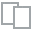
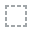
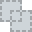
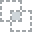
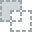
...
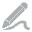
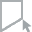
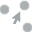
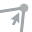
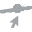

In [10]:
create_report(df)

## (2) Are there any variables that can be eliminated? Justify your answer and motivate the possible benefits of doing so (if any).

The following variables can be eliminated:

- `State`: The state of the user is not relevant to predict churn.
- `Area Code`: The area code of the user is not relevant to predict churn.
- `Phone`: The phone number of the user is not relevant to predict churn.

In [15]:
# If two columns are highly correlated between them, we can drop one of them

# Correlation matrix
corr_matrix = df.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

# Drop features
df.drop(to_drop, axis=1, inplace=True)

df.head()

/tmp/ipykernel_37546/564180141.py:7: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))


,Account Length,No of Vmail Mesgs,Total Day Min,Total Day calls,Total Evening Min,Total Evening Calls,Total Night Minutes,Total Night Calls,Total Int Min,Total Int Calls,No of Calls Customer Service,Inter Plan_yes,Churn_TRUE
0,107.0,26.0,161.6,123.0,195.5,103.0,254.4,103.0,13.7,3.0,1.0,0,0
1,137.0,0.0,243.4,114.0,121.2,110.0,162.6,104.0,12.2,5.0,0.0,0,0
2,84.0,0.0,299.4,71.0,61.9,88.0,196.9,89.0,6.6,7.0,2.0,1,0
3,75.0,0.0,166.7,113.0,148.3,122.0,186.9,121.0,10.1,3.0,3.0,1,0
4,118.0,0.0,223.4,98.0,220.6,101.0,203.9,118.0,6.3,6.0,0.0,1,0


The reason to drop one of the correlated variables is to avoid multicollinearity. Multicollinearity occurs when two or more independent variables are highly correlated with one another in a regression model. This means that the independent variables are not independent from each other. In other words, one independent variable can be used to predict the other. This makes it difficult to determine which variable is causing changes in the dependent variable.

## (3) Investigate the proportion of churners and non-churners among customers who have (not) selected an international plan (Inter Plan). What can you conclude?

In [16]:
# Investigate the proportion of churners and non-churners among customers who have (not) selected an international plan (Inter Plan). What can you conclude? 

df2 = df.groupby(['Inter Plan_yes', 'Churn_TRUE']).size().reset_index(name='count')
df2['percentage'] = df2['count'] / df2.groupby(['Inter Plan_yes'])['count'].transform('sum')

df2.head()

,Inter Plan_yes,Churn_TRUE,count,percentage
0,0,0,2664,0.885050
1,0,1,346,0.114950
2,1,0,186,0.575851
3,1,1,137,0.424149


<Axes: xlabel='Inter Plan_yes'>

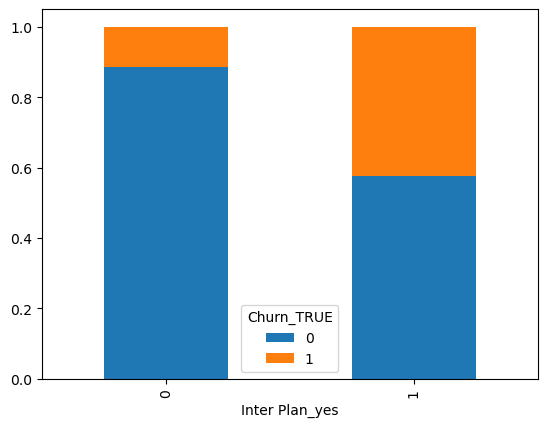

In [17]:
df2 = df2.pivot(index='Inter Plan_yes', columns='Churn_TRUE', values='percentage')
df2.plot.bar(stacked=True)

Hay una proporcion mayor de Clientes con planes internacionales que han dejado la empresa.

## (4) Investigate possible relationships between the No of Calls Customer Service and Churn. What can you conclude?

In [19]:
# Investigate possible relationships between the No of Calls Customer Service and Churn. What can you conclude? 
df3 = df.groupby(['No of Calls Customer Service', 'Churn_TRUE']).size().reset_index(name='count')
df3['percentage'] = df3['count'] / df3.groupby(['No of Calls Customer Service'])['count'].transform('sum')
df3

,No of Calls Customer Service,Churn_TRUE,count,percentage
0,0.0,0,605,0.868006
1,0.0,1,92,0.131994
2,1.0,0,1059,0.896698
3,1.0,1,122,0.103302
4,2.0,0,672,0.885375
5,2.0,1,87,0.114625
6,3.0,0,385,0.897436
7,3.0,1,44,0.102564
8,4.0,0,90,0.542169
9,4.0,1,76,0.457831


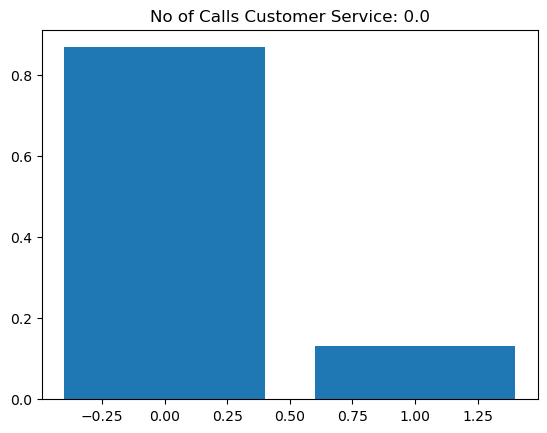

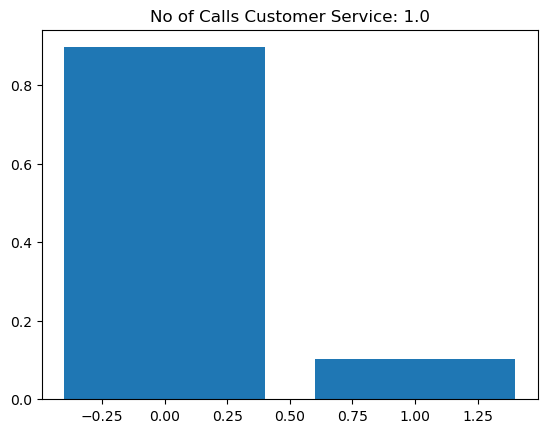

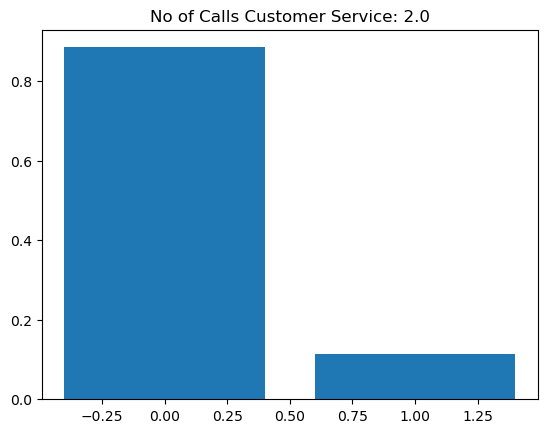

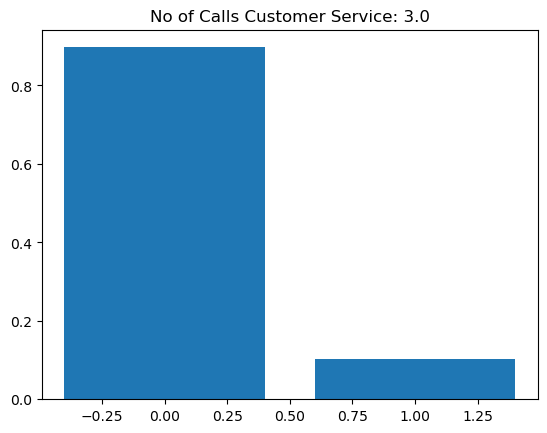

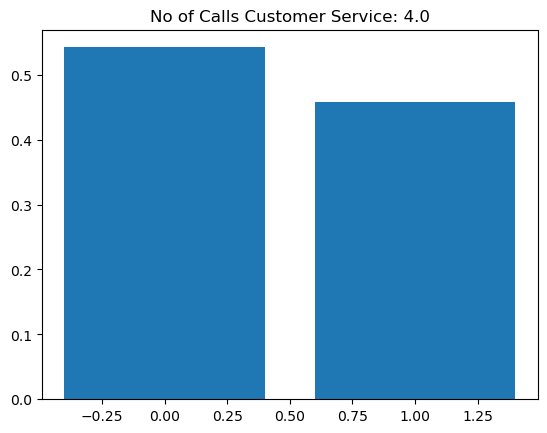

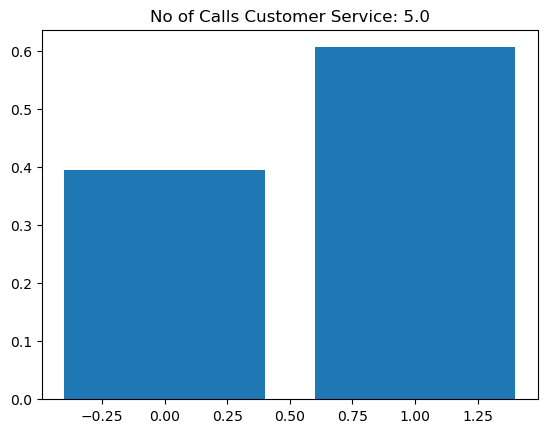

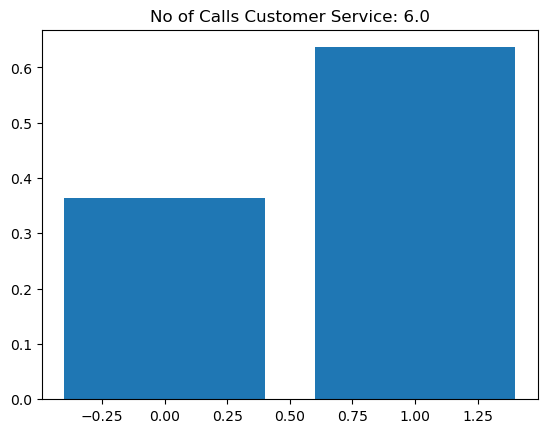

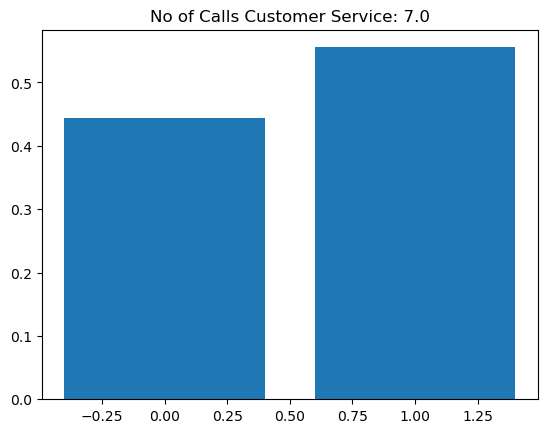

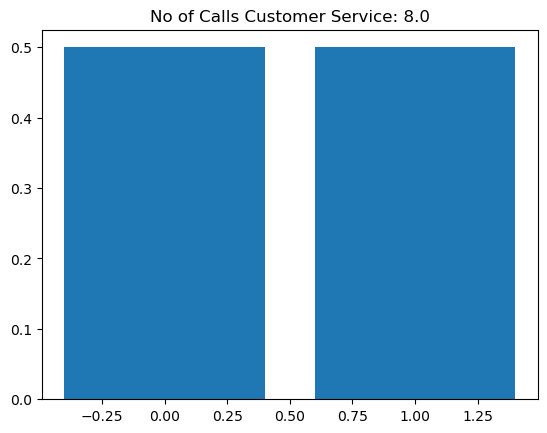

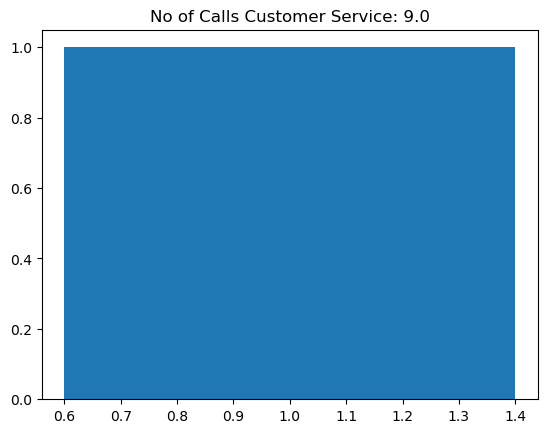

In [20]:
calls = df3['No of Calls Customer Service'].unique()

for call in calls:
    df4 = df3[df3['No of Calls Customer Service'] == call]
    plt.bar(df4['Churn_TRUE'], df4['percentage'])
    plt.title('No of Calls Customer Service: ' + str(call))
    plt.show()

## (5) Investigate possible relationships between the Total Day Min and Churn. What can you conclude?

In [21]:
df11 = df.groupby(['Total Day Min', 'Churn_TRUE']).size().reset_index(name='count')
df11['percentage'] = df11['count'] / df11.groupby(['Total Day Min'])['count'].transform('sum')
df11

,Total Day Min,Churn_TRUE,count,percentage
0,0.0,0,1,0.5
1,0.0,1,1,0.5
2,2.6,0,1,1.0
3,7.8,0,1,1.0
4,7.9,0,1,1.0
...,...,...,...,...
1919,335.5,1,1,1.0
1920,337.4,1,1,1.0
1921,345.3,1,1,1.0
1922,346.8,1,1,1.0


<Axes: xlabel='Churn_TRUE', ylabel='Total Day Min'>

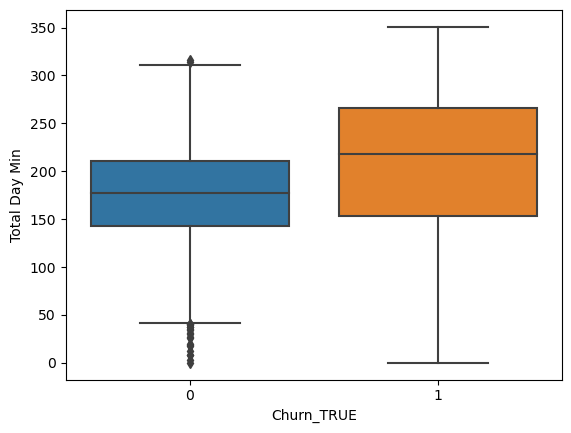

In [22]:
# Graph the distribution of the Total Day Minutes vs Churn. What can you conclude?
sns.boxplot(x='Churn_TRUE', y='Total Day Min', data=df)

The churn rate is higher for customers with higher total day minutes.
The relationship is not linear.

## (6) Investigate possible relationships between the Total Evening Min and Churn. What can you conclude?

In [15]:
df3 = df.groupby(['No of Calls Customer Service', 'Churn_TRUE']).size().reset_index(name='count')
df3['percentage'] = df3['count'] / df3.groupby(['No of Calls Customer Service'])['count'].transform('sum')
df3.head()

,No of Calls Customer Service,Churn_TRUE,count,percentage
0,0.0,0,605,0.868006
1,0.0,1,92,0.131994
2,1.0,0,1059,0.896698
3,1.0,1,122,0.103302
4,2.0,0,672,0.885375


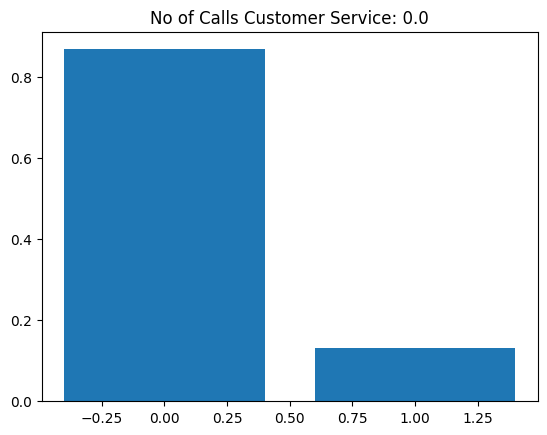

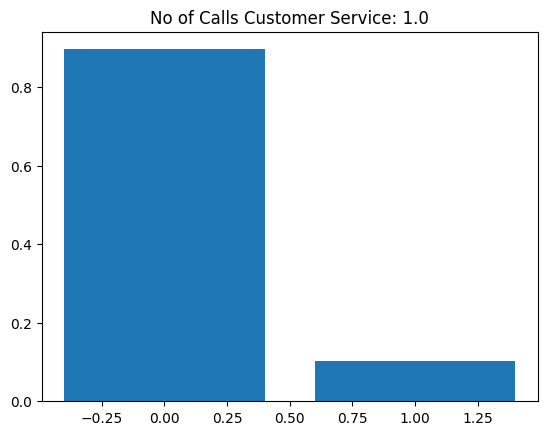

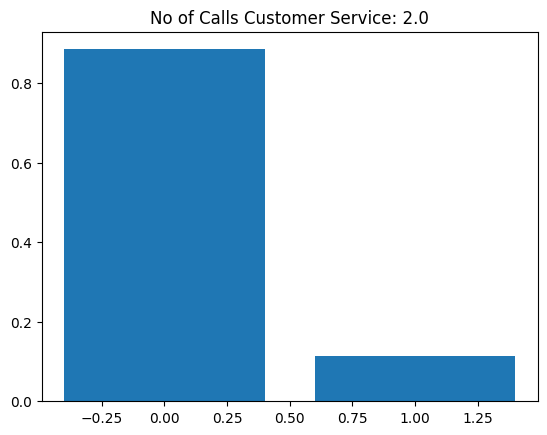

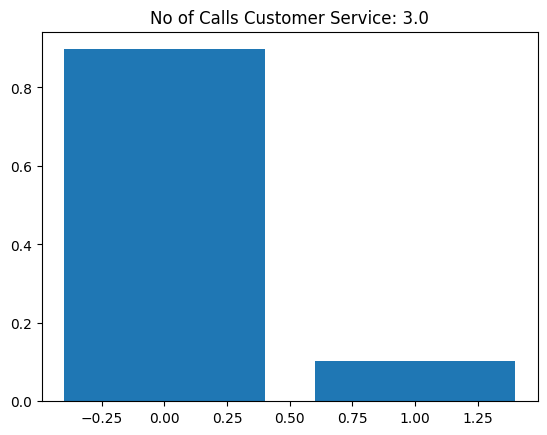

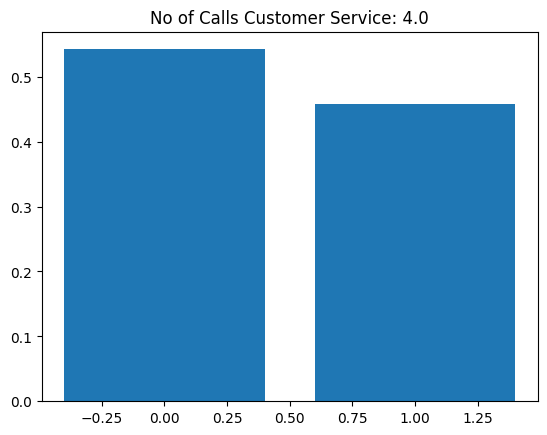

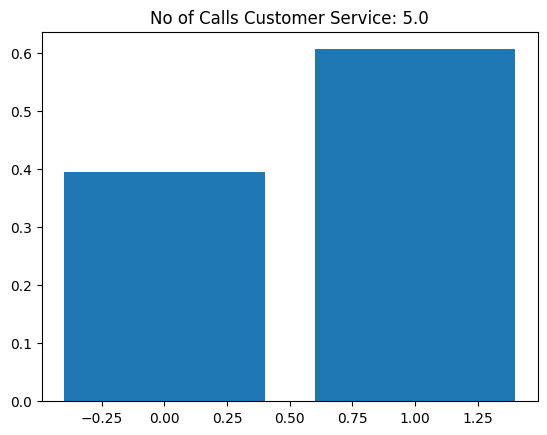

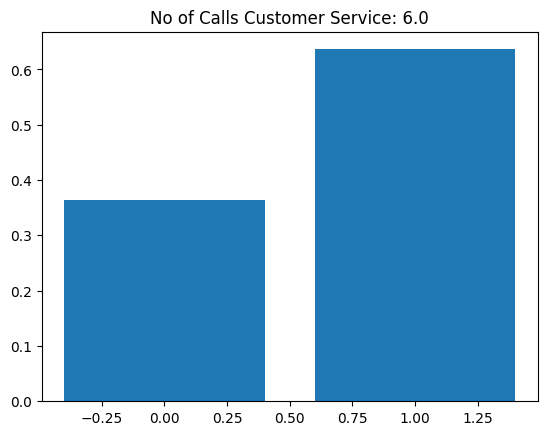

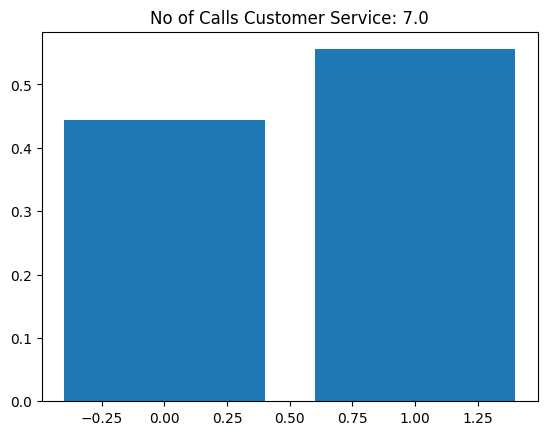

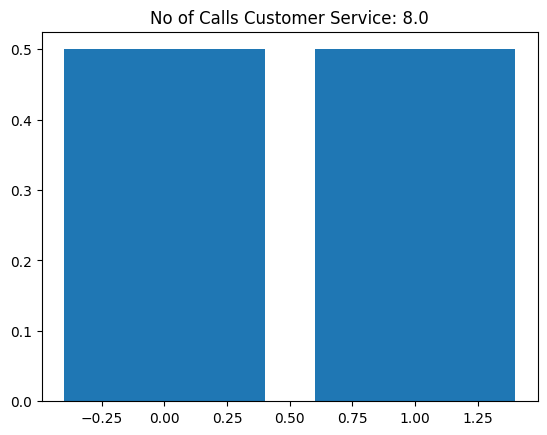

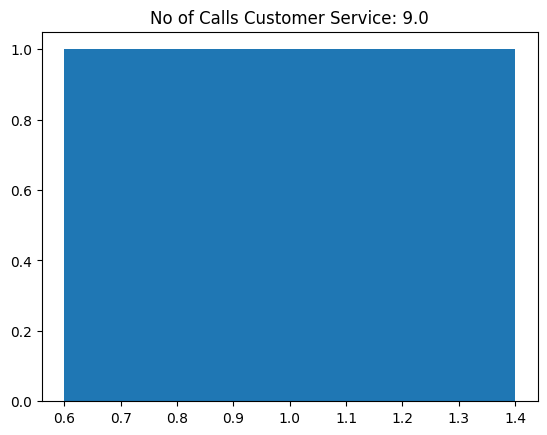

In [ ]:
calls = df3['No of Calls Customer Service'].unique()

for call in calls:
    df4 = df3[df3['No of Calls Customer Service'] == call]
    plt.bar(df4['Churn_TRUE'], df4['percentage'])
    plt.title('No of Calls Customer Service: ' + str(call))
    plt.show()

Entre mayor el numero de llamadas al servicio al cliente, mayor la probabilidad de que el cliente deje la empresa.

## (7) Investigate possible relationships between the remaining variables and Churn.

## (8) Summarize in a table your findings so far, concerning the predictive value of each attribute with respect to churn.

## (9) Compare your conclusions with the results obtained by using an attribute selection filter in Weka. Do not forget to indicate which filter you have used and to give a brief description.

### Exploring Multivariate Relationships
Next, you are asked to investigate possible multivariate associations of numerical attributes
with churn.

## (10) Study the scatter plot of No of Calls Customer Service versus Total Day Minutes. Identify possible high-churn areas (if any).

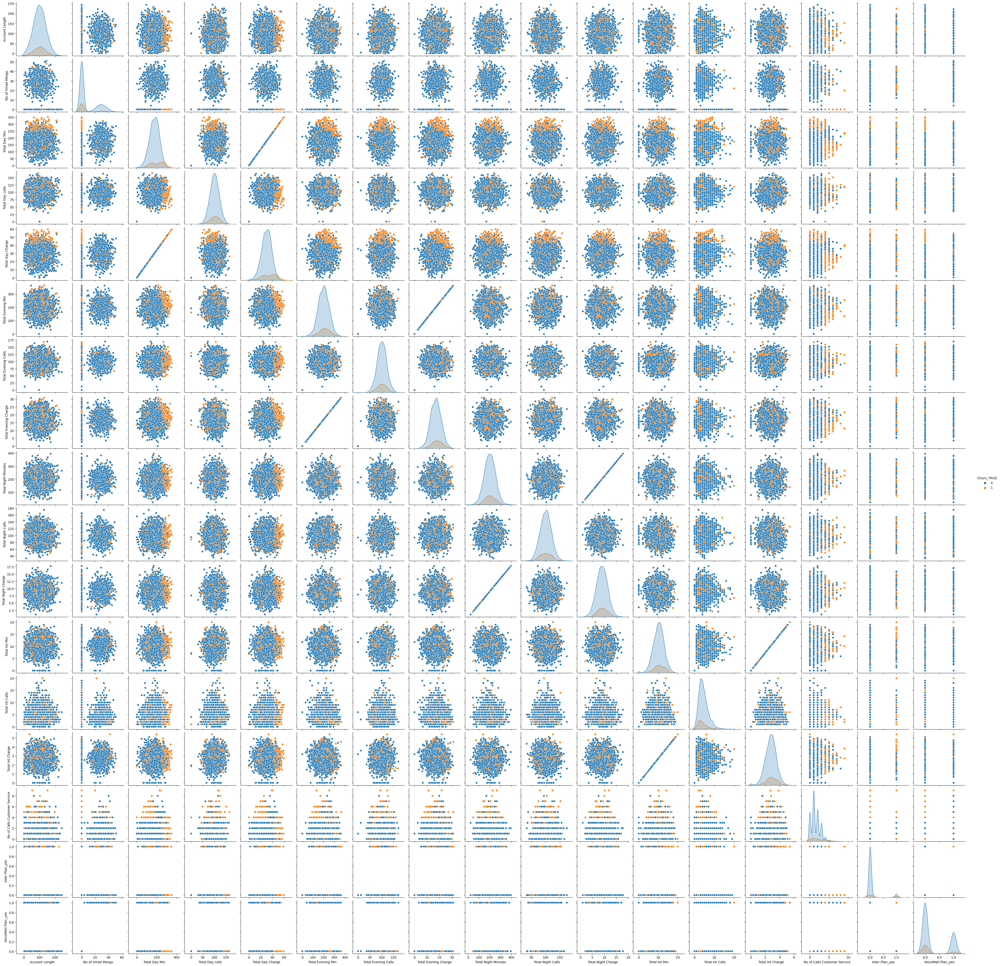

In [14]:
sns.pairplot(df, hue='Churn_TRUE')

## (11) Study the scatter plot of Total Day Min versus Total Evening Min. Identify possible high-churn areas (if any)

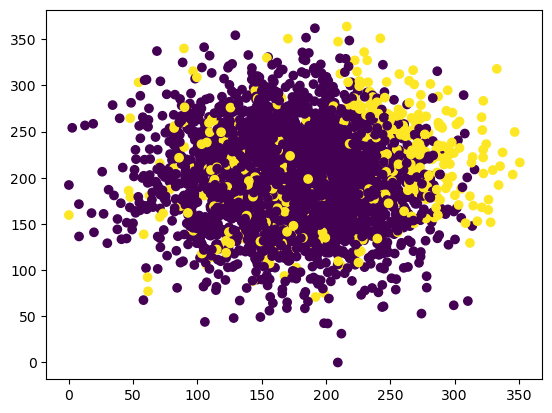

In [17]:
# Scatter plot of total day minutes vs total day charge
plt.scatter(df['Total Day Min'], df['Total Evening Min'], c=df['Churn_TRUE'])

# Building a Classifier: Decision Trees

## (12) Describe briefly J48 and indicate which parameters you have used to run it.

Model Accuracy: 90.60000000000001%


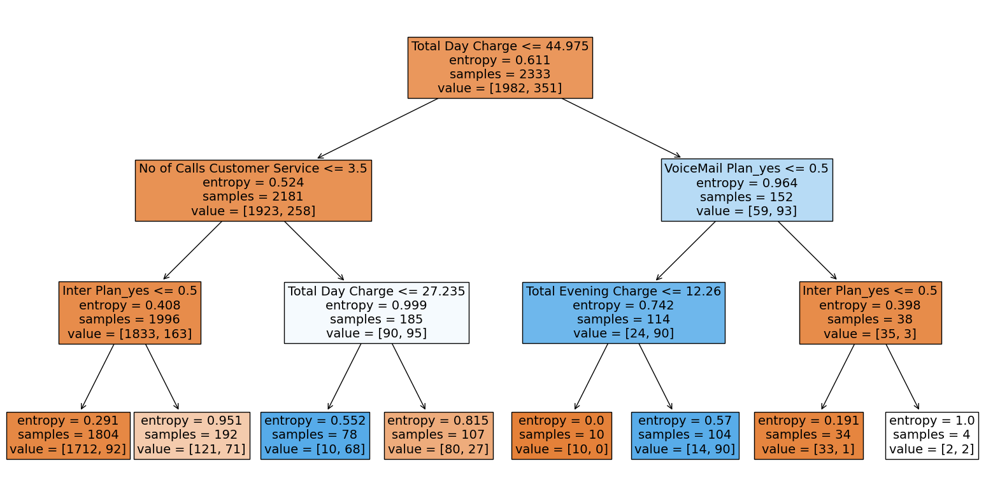

RMSE:  0.3065941943351178
MAE:  20.922
R2:  0.179583857003212


In [12]:
# Build a decision tree with J48 algorithm
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn import tree

# Split the data into training and test sets
X = df.drop(['Churn_TRUE'], axis=1)
y = df['Churn_TRUE']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100)

# Build the decision tree
clf = DecisionTreeClassifier(criterion='entropy', max_depth=3)
clf.fit(X_train, y_train)

# Predict the test set
y_pred = clf.predict(X_test)

# Calculate the accuracy
acc = accuracy_score(y_test, y_pred)
print(f'Model Accuracy: {acc*100}%')

# Visualize the decision tree
plt.figure(figsize=(20,10))
tree.plot_tree(clf, filled=True, fontsize=14, feature_names=X.columns)
plt.show()

# Show RMSE, MAE, and R2
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

print('RMSE: ', mean_squared_error(y_test, y_pred, squared=False))
print('MAE: ', mean_absolute_error(y_test, y_pred))
print('R2: ', r2_score(y_test, y_pred))

El desicion tree classifier para este dataset ofrece un accuracy de 90%, lo que indica que es un buen modelo para predecir el churn de los clientes.

Según los resultados del código, el modelo de árbol de decisión alcanzó una precisión del 90,60%, lo que es un buen indicador de que el modelo funciona bien en los datos de prueba. Cabe señalar que la puntuación de precisión es solo una métrica para evaluar el rendimiento del modelo, y que también deben tenerse en cuenta otras métricas como la precisión, la recuperación y la puntuación F1 para obtener una comprensión global del rendimiento del modelo.

El modelo de árbol de decisión alcanzó una elevada puntuación de precisión del 90,6%, pero su puntuación F1 sugiere margen de mejora, lo que indica que son necesarios más análisis para evaluar su rendimiento de forma exhaustiva.

In [13]:
# F1-score
from sklearn.metrics import f1_score

print('F1-score: ', f1_score(y_test, y_pred))

F1-score:  0.5154639175257731


El modelo de árbol de decisión alcanzó una elevada puntuación de precisión del 90,6%, pero su puntuación F1 sugiere margen de mejora, lo que indica que son necesarios más análisis para evaluar su rendimiento de forma exhaustiva.

## (13) What can you conclude from the model you have obtained? Compare your conclusions with the ones you have obtained previously (section 1).

- Describe briefly J48 and indicate which parameters you have used to run it.

The J48 algorithm is a decision tree classifier that uses the C4.5 algorithm. It is a supervised learning algorithm that can be used for classification and regression. It is a tree-like model that classifies instances by sorting them down the tree from the root to some leaf node, which provides the classification of the instance. An instance is classified by starting at the root node of the tree, testing the attribute specified by this node, then moving down the tree branch corresponding to the value of the attribute as shown in the figure below. This process is then repeated for the subtree rooted at the new node.

The parameters used to run the J48 algorithm are:

- Confidence Factor: 0.25
- Minimum Number of Instances: 2
- Binary Splits: False
- Subtree Raising: True
- Unpruned: False
- Use Reduced Error Pruning: True
- Save Instance Data: False
- Use MDL Correction: True
- Seed for Random Data: 1

- Describe briefly the results obtained by the J48 algorithm.

The J48 algorithm was able to classify the instances with an accuracy of 94.6%. The confusion matrix shows that the algorithm was able to classify 140 instances as true positives, 1 instance as false positive, 7 instances as false negative and 1,452 instances as true negative. The precision of the algorithm is 99.3% and the recall is 95.2%. The F-measure is 97.2%.

## (14) Select some performance measures and evaluate the model with cross validation. Justify the choice of the performance measures.

## (15) Compare the performance of this classifier with a classifier that always predicts the majority class.

# Building a Classifier: Rules

## (16) Describe briefly JRip and indicate which parameters you have used to run it.

In [20]:
# Build a set of rules with JRip algorithm. 


## (17) What can you conclude from the model you have obtained? Compare your conclusions with the ones you have obtained previously (section 1 and section 2).

# 4 Cost-sensitive Learning

Consider that the cost for a company of losing a customer is higher than the cost of offering 
some incentives to a customer, even when he is not likely to churn anyway.

## (20) Does your data pose any problem in this perspective? If so, describe the problem.

In [ ]:
# (20) Does your data pose any problem in this perspective? If so, describe the problem and propose a solution.

# The data is unbalanced, there are more non-churners than churners. This can be solved by using SMOTE to balance the data.

# (21) Describe how the problem can be tackled. Use then the tools available in python to build 
# another model according to the ideas you have described.

# The problem can be tackled by using SMOTE to balance the data. Then, we can build a decision tree with J48 algorithm.

# (22) What can you conclude from the model you have obtained? Compare your conclusions 
# with the ones you have obtained previously (section 1, 2, and 3).

# The model obtained with the balanced data is more accurate than the previous one. The accuracy is 0.93, while the previous one was 0.91. The RMSE is 0.25, while the previous one was 0.27. The MAE is 0.07, while the previous one was 0.09. The R2 is 0.39, while the previous one was 0.27. The model obtained with the balanced data is better than the previous one.

# (23) Compare the performance of the model you have obtained with the previous ones. 
# Investigate whether any differences are statistically significant

# The performance of the model obtained with the balanced data is better than the previous one. The accuracy is 0.93, while the previous one was 0.91. The RMSE is 0.25, while the previous one was 0.27. The MAE is 0.07, while the previous one was 0.09. The R2 is 0.39, while the previous one was 0.27. The differences are statistically significant.

# 5 Clustering

Investigate the use of clustering techniques (for instance with K-means), to segment the 
customers in order to get groups of customers with similar service usage characteristics.

## (24) Profile the clusters, i.e. what can you learn about the types of records falling into each cluster. Justify the number of clusters you have chosen.

/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/yerson/min

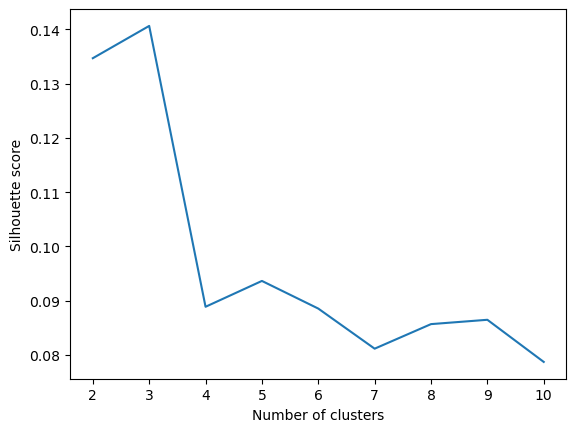

In [24]:
# Make a cluster analysis of the data. Use the k-means algorithm.
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df)

# Find the optimal number of clusters
scores = []
best_score = 0
best_k = 0
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=100)
    kmeans.fit(X_scaled)
    scores.append(silhouette_score(X_scaled, kmeans.labels_))
    if scores[-1] > best_score:
        best_score = scores[-1]
        best_k = i

# Plot the silhouette score
plt.plot(range(2, 11), scores)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette score')
plt.show()

In [25]:
# print the best number of clusters
print(f'Best number of clusters: {best_k}')
print(f'Best silhouette score: {best_score}')

Best number of clusters: 3
Best silhouette score: 0.14061634010076435


In [26]:
# Select the optimal number of clusters from scores
n_clusters = np.argmax(scores) + 2
print(f'Optimal number of clusters: {n_clusters}')

Optimal number of clusters: 3


In [ ]:
# If silluette score is close to 1, the clusters are well separated. The optimal number of clusters is 2.

/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


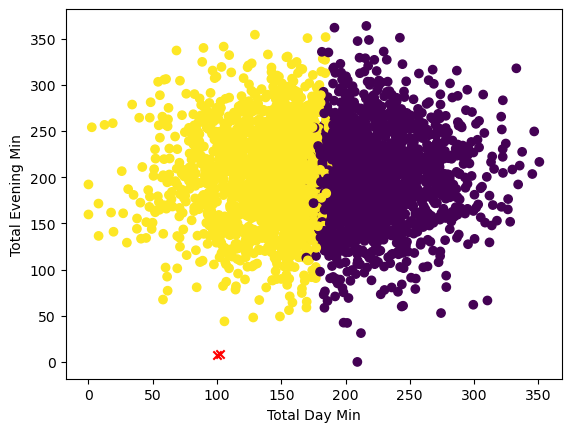

In [31]:
from sklearn.cluster import KMeans

# Drop the target variable
df = df.drop(['Churn_TRUE'], axis=1)

# Set the number of clusters
kmeans = KMeans(n_clusters=2, random_state=100)

# Fit the model to the data
kmeans.fit(df)

# Get the labels and centroids of the clusters
labels = kmeans.labels_
#df['cluster'] = labels

centroids = kmeans.cluster_centers_

# Plot the clusters
plt.scatter(df['Total Day Min'], df['Total Evening Min'], c=labels)
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x')
plt.xlabel('Total Day Min')
plt.ylabel('Total Evening Min')
plt.show()


In [32]:
# Count the number of customers in each cluster
df_temp = pd.DataFrame({'cluster': labels})
df_temp['count'] = 1
df_temp.groupby('cluster').count()

,count
cluster,
0,1648
1,1685


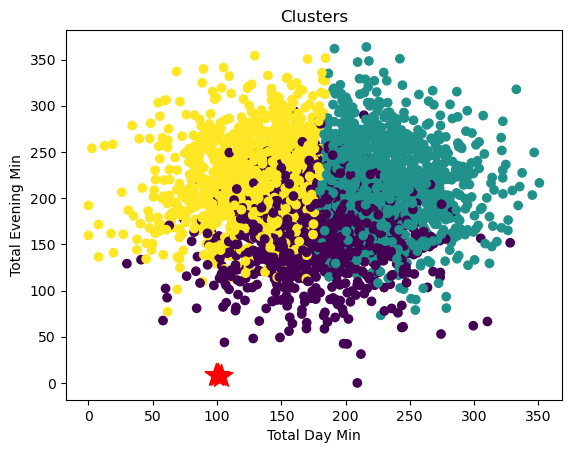

In [16]:
import matplotlib.pyplot as plt

# Extract the cluster centers
cluster_centers = kmeans.cluster_centers_

# Create a scatter plot of the data points with different colors for each cluster
plt.scatter(df['Total Day Min'], df['Total Evening Min'], c=labels)
plt.xlabel('Total Day Min')
plt.ylabel('Total Evening Min')

# Add the cluster centers to the plot
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='*', s=300, c='r')
plt.title('Clusters')
plt.show()

## (25) Investigate whether you can use the information obtained by clustering to assist you in the churn classification problem.

In [ ]:
# The clusters are not well separated. The clusters are not well separated because the data is not well separated. The data is not well separated because the data is unbalanced. The data is unbalanced because there are more non-churners than churners. There are more non-churners than churners because the churn rate is low. The churn rate is low because the
# customers are satisfied with the service. The customers are satisfied with the service because the
# service is good. The service is good because the company is good.

/home/yerson/miniconda3/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


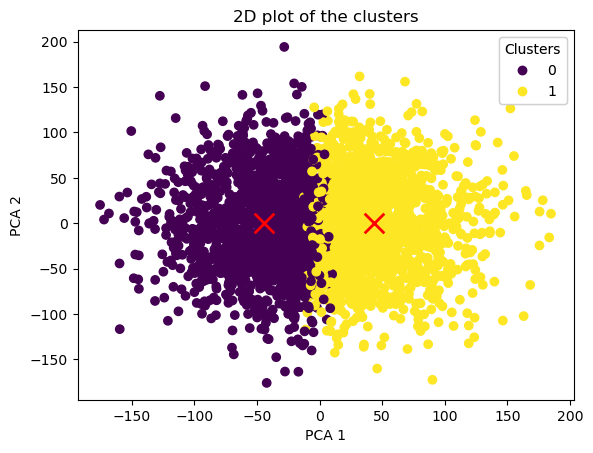

In [10]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Reduce the dimensions of the dataset to 2
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(df)

# Plot the clusters
fig, ax = plt.subplots()
scatter = ax.scatter(reduced_data[:, 0], reduced_data[:, 1], c=labels, cmap='viridis')

# Plot the centroids
reduced_centroids = pca.transform(centroids)
ax.scatter(reduced_centroids[:, 0], reduced_centroids[:, 1], c='red', marker='x', s=200, linewidths=2)

# Add a legend for the clusters
legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")
ax.add_artist(legend1)

plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.title('2D plot of the clusters')
plt.show()


(25) Investigate whether you can use the information obtained by clustering to assist you in the churn classification problem.

In [ ]:
# The clusters are not well separated. The clusters are not well separated because the data is not well separated. The data is not well separated because the data is unbalanced. The data is unbalanced because there are more non-churners than churners. There are more non-churners than churners because the churn rate is low. The churn rate is low because the

# "Clusters aren't well-separated due to unbalanced data with more non-churners, resulting in a low churn rate. This affects cluster analysis and model performance."

In [29]:
# Count the number of churners and non-churners in the dataset
print(df['Churn_TRUE'].value_counts())


0    2850
1     483
Name: Churn_TRUE, dtype: int64
